In [ ]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

import torch
import torch.optim as optim
from torchvision import models
from torchvision import transforms as tf
from torch.nn import functional as F

vgg = models.vgg19(pretrained=True).features
for param in vgg.parameters():
    param.requires_grad_(False)

device = torch.device("cpu")
if torch.cuda.is_available():
    device = torch.device("cuda")

vgg.to(device)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 548M/548M [00:04<00:00, 135MB/s]


Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

In [ ]:
print(next(vgg.parameters()).device)

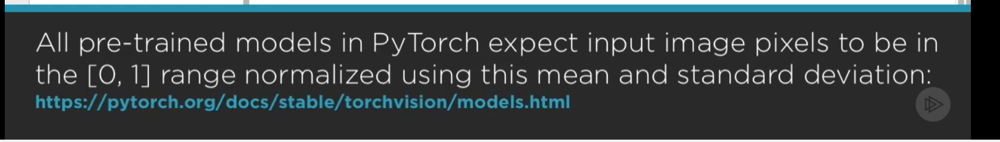

In [ ]:
mean = (0.485, 0.456, 0.406)
std = (0.229, 0.224, 0.225)

def transformation(img):
    tasks = tf.Compose([tf.Resize(256),
                        tf.ToTensor(),
                        tf.Normalize(mean, std)])
    img = tasks(img)
    img = img.unsqueeze(0) #->add batch dim
    return img

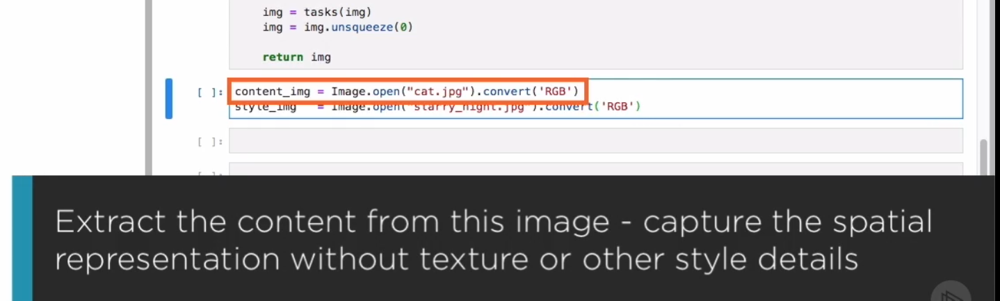

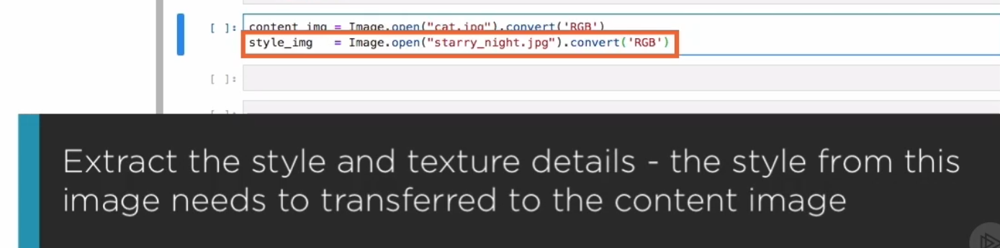

In [ ]:
content_img=Image.open("cat.jpg").convert("RGB")
style_img = Image.open("starry night.jpg").convert('RGB')

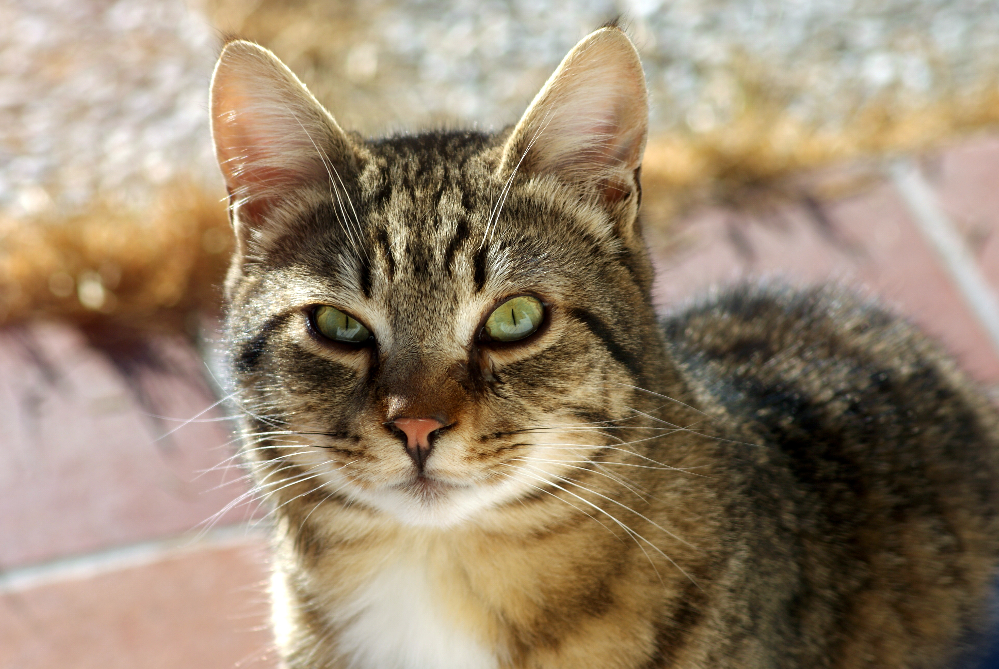

In [ ]:
content_img

In [ ]:
content_img.size,style_img.size

((3872, 2592), (1300, 1064))

In [ ]:
# content_img.shape errror

AttributeError: 'Image' object has no attribute 'shape'

In [ ]:
# get dataallows u to fet individual pixels of the image
list(content_img.getdata())

[(214, 195, 181),
 (211, 192, 178),
 (209, 190, 176),
 (209, 190, 176),
 (211, 192, 178),
 (211, 192, 178),
 (210, 191, 177),
 (210, 191, 177),
 (212, 193, 178),
 (211, 192, 177),
 (211, 192, 177),
 (210, 191, 176),
 (210, 191, 176),
 (210, 191, 176),
 (211, 192, 177),
 (213, 191, 178),
 (214, 192, 179),
 (214, 190, 180),
 (212, 190, 177),
 (213, 191, 178),
 (214, 192, 179),
 (215, 193, 180),
 (213, 194, 179),
 (213, 194, 179),
 (214, 198, 182),
 (214, 198, 182),
 (211, 198, 181),
 (210, 197, 180),
 (210, 197, 181),
 (210, 197, 181),
 (210, 198, 182),
 (211, 197, 184),
 (217, 201, 188),
 (216, 198, 188),
 (211, 197, 186),
 (211, 197, 186),
 (209, 199, 189),
 (209, 199, 189),
 (209, 199, 190),
 (210, 200, 191),
 (214, 201, 193),
 (213, 198, 191),
 (212, 197, 190),
 (215, 196, 190),
 (216, 197, 190),
 (217, 197, 190),
 (217, 197, 190),
 (216, 197, 191),
 (215, 200, 193),
 (214, 201, 195),
 (214, 201, 193),
 (214, 201, 193),
 (213, 200, 192),
 (213, 200, 192),
 (211, 201, 191),
 (211, 201

In [ ]:
style_img.size,list(style_img.getdata())

((1300, 1064),
 [(31, 56, 218),
  (33, 57, 217),
  (37, 60, 218),
  (41, 60, 216),
  (38, 49, 203),
  (25, 32, 183),
  (17, 21, 172),
  (18, 19, 169),
  (7, 6, 160),
  (21, 20, 176),
  (5, 5, 165),
  (25, 27, 190),
  (37, 39, 210),
  (22, 28, 202),
  (39, 46, 223),
  (43, 50, 227),
  (17, 20, 195),
  (51, 52, 230),
  (16, 17, 206),
  (29, 29, 221),
  (21, 22, 211),
  (34, 36, 217),
  (35, 42, 211),
  (29, 36, 204),
  (37, 44, 220),
  (20, 25, 215),
  (21, 23, 232),
  (23, 23, 243),
  (3, 6, 223),
  (0, 2, 208),
  (0, 8, 195),
  (0, 7, 172),
  (0, 12, 154),
  (0, 12, 148),
  (26, 40, 188),
  (80, 90, 222),
  (92, 102, 199),
  (162, 180, 244),
  (202, 231, 255),
  (134, 173, 228),
  (48, 96, 198),
  (48, 104, 243),
  (50, 108, 255),
  (24, 85, 255),
  (13, 74, 243),
  (19, 74, 239),
  (62, 110, 255),
  (5, 51, 207),
  (36, 82, 219),
  (60, 108, 236),
  (49, 97, 233),
  (58, 111, 227),
  (58, 117, 195),
  (136, 201, 255),
  (145, 209, 255),
  (68, 130, 205),
  (129, 183, 255),
  (58, 108,

00:02:54.203 --> 00:02:58.123
and you can see that the RGB values of the pixel are

00:02:58.123 --> 00:03:01.047
specified using integers from 0 to 255.

00:03:01.047 --> 00:03:05.737
All of the pretrained models in PyTorch have been trained on images where

00:03:05.737 --> 00:03:10.145
the RGB values have been specified in the 0 to 1 range,

00:03:10.145 --> 00:03:13.317
so the convolutional filter weights and the feature maps will

00:03:13.317 --> 00:03:17.185
not be activated when you specify input images in a different

00:03:17.185 --> 00:03:19.806
range that is with integers 0 to 255.

00:03:19.806 --> 00:03:25.494
If you try to feed this VGG19 model with 0 to 255 tensor images,

00:03:25.494 --> 00:03:28.813
then the activated feature maps will be unable to

00:03:28.813 --> 00:03:31.864
sense either the content or the style.

00:03:31.865 --> 00:03:35.802
The transformation function will convert the content image and

00:03:35.802 --> 00:03:38.305
the style image to the required pixel ranges,

00:03:38.305 --> 00:03:40.141
as well as resize them,

00:03:40.141 --> 00:03:44.695
and we will move all of the images over to our cuda device.

In [ ]:
content_img = transformation(content_img).to(device)
style_img = transformation(style_img).to(device)

In [ ]:
content_img.shape

torch.Size([1, 3, 256, 382])

In [ ]:
content_img.size

<function Tensor.size>

thjats why we use transpose

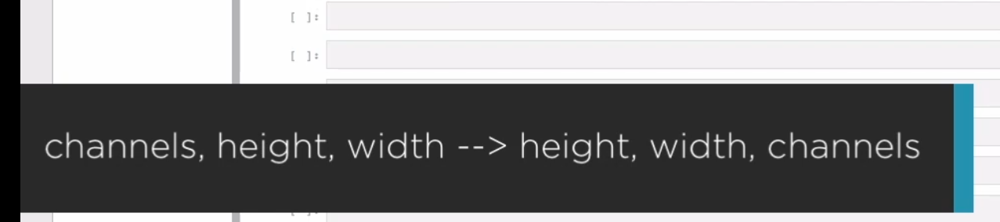

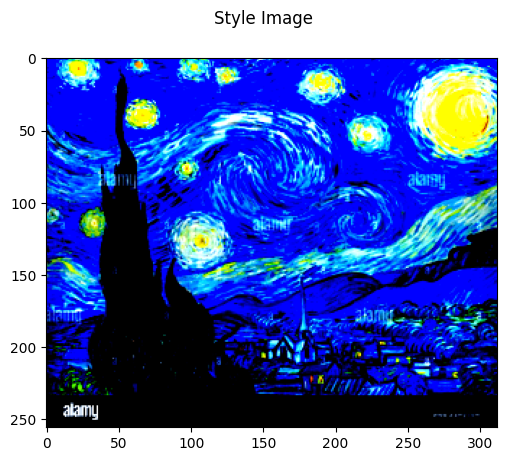

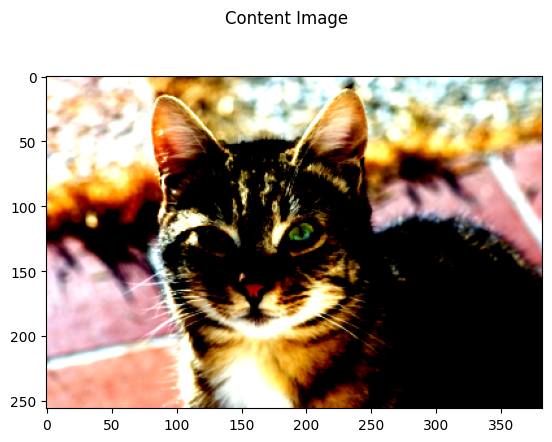

In [ ]:
def tensor_to_image(tensor):
    image = tensor.clone().detach()  #clone(): Makes a copy of the tensor so that changing image won’t affect tensor.
# detach(): Makes sure the new tensor (image) is no longer connected to PyTorch's computation graph. This means it won’t track gradients or affect backpropagation.
    image = image.cpu().numpy().squeeze() #remove the batch dim here which we added
    image = image.transpose(1, 2, 0) #c,h,w---->h.w.c
    image *= np.array(std) + np.array(mean) #denormalize the image
    image = image.clip(0, 1) #clip pixels va;ues into 0 and 1
    return image

img = tensor_to_image(style_img)
fig = plt.figure()
fig.suptitle('Style Image')
plt.imshow(img)

img = tensor_to_image(content_img)
fig = plt.figure()
fig.suptitle('Content Image')
plt.imshow(img)

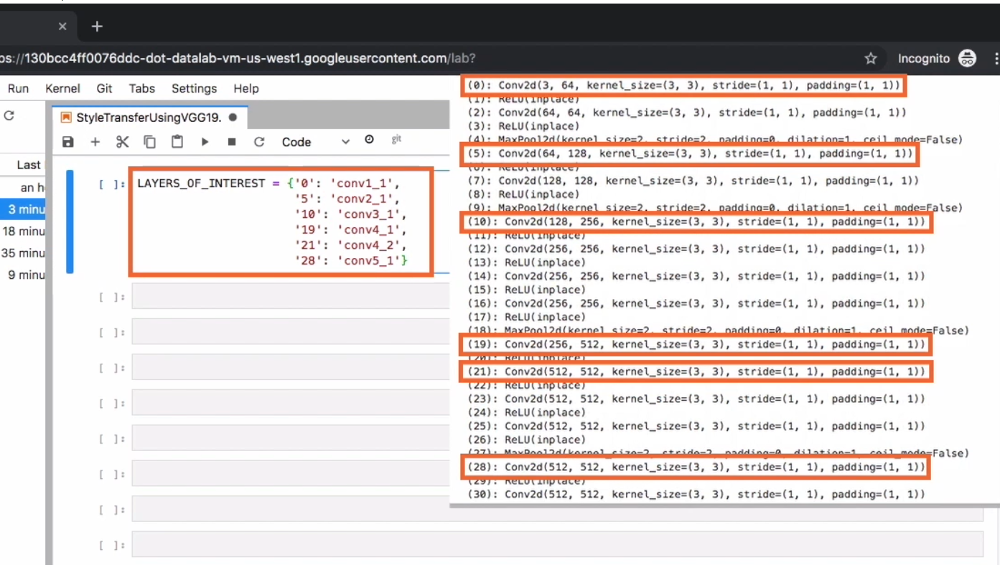

We are now ready to specify which layers of the

00:00:03.758 --> 00:00:05.769
convolutional neural network we are interested in.

00:00:05.769 --> 00:00:09.009
These are the layers that will allow us to extract either

00:00:09.009 --> 00:00:12.013
content information or style information.

00:00:12.013 --> 00:00:16.362
Now the fact is that the feature maps of the earlier convolutional layers

00:00:16.362 --> 00:00:20.582
represent the content much better as they are closer to the input.

00:00:20.582 --> 00:00:25.400
Observe that all of the layers of interest here are convolutional layers.

00:00:25.401 --> 00:00:28.910
You can see the layers highlighted here off to the right.

00:00:28.910 --> 00:00:32.615
Some of the layers are earlier layers such as 0, 5, and 10.

00:00:32.616 --> 00:00:35.250
We've also chosen some of the later layers,

00:00:35.250 --> 00:00:39.201
but we will give them lower weights as you'll see in just a bit.



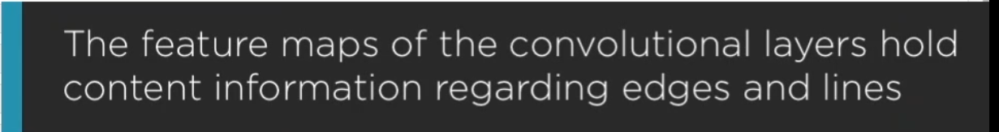

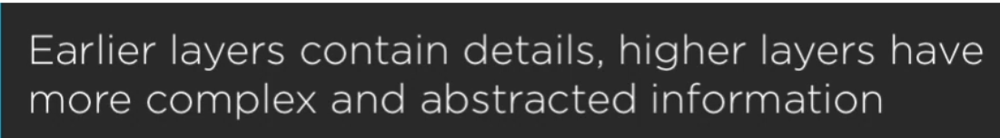

In [ ]:
LAYERS_OF_INTEREST = {'0': 'conv1_1',
                      '5': 'conv2_1',
                      '10': 'conv3_1',
                      '19': 'conv4_1',
                      '21': 'conv4_2',
                      '28': 'conv5_1'}



I'm going to now define another helper function that will apply the layers

00:01:08.456 --> 00:01:14.053
of the VGG19 model to the input image and extract specific features from

00:01:14.053 --> 00:01:16.671
the feature maps in which we are interested.

00:01:16.671 --> 00:01:19.594
The input arguments here are the image itself,

00:01:19.595 --> 00:01:23.694
as well as the layers of the VGG19 model.

00:01:23.695 --> 00:01:26.185
I've assigned the input image tensor to the variable x,

00:01:26.185 --> 00:01:31.868
and I'm going to set up a dictionary for the feature map representations.

00:01:31.868 --> 00:01:34.232
This will contain all of the feature maps that are the

00:01:34.232 --> 00:01:36.495
output of the layers that I'm interested in.

00:01:36.495 --> 00:01:41.242
We'll apply the VGG model to the input layer by layer.

00:01:41.242 --> 00:01:44.094
So for every layer in the model modules.items,

00:01:44.094 --> 00:01:49.486
pass the input image x through that layer and store the

00:01:49.486 --> 00:01:52.612
resulting feature map in the variable x once again.

00:01:52.612 --> 00:01:56.108
The variable x now holds the output after having passed

00:01:56.108 --> 00:01:58.669
the input through the current layer.

00:01:58.670 --> 00:02:01.875
Now let's check whether the current layer is a layer of interest.

00:02:01.875 --> 00:02:03.889
If the name of the layer is in the layers of

00:02:03.889 --> 00:02:05.588
interest that we had defined earlier,

00:02:05.588 --> 00:02:10.336
I'm going to add the output of this particular layer to my features

00:02:10.336 --> 00:02:13.667
dictionary so the output of a layer can be looked up by the name

00:02:13.667 --> 00:02:16.262
which we have assigned to the layer, conv1_1,

00:02:16.262 --> 00:02:19.551
conv2_1, and so on.

00:02:19.552 --> 00:02:21.221
With the completion of this for loop,

00:02:21.221 --> 00:02:23.762
the input image would have been passed through all

00:02:23.762 --> 00:02:29.681
of the layers of the VGG19 model, and we can then return the features dictionary.



In [ ]:
def apply_model_and_extract_features(image, model):
    x = image
    features = {}

    for name, layer in model._modules.items():
        x = layer(x)

        if name in LAYERS_OF_INTEREST:
            features[LAYERS_OF_INTEREST[name]] = x

    return features

Because we are using this model for neural style transfer,

00:02:32.246 --> 00:02:35.302
we are not interested in the final output of the model.

00:02:35.302 --> 00:02:39.910
We are only interested in the output generated by our layers of interest.

00:02:39.911 --> 00:02:42.485
I am now going to pass both the content image,

00:02:42.485 --> 00:02:46.043
as well as the style image through the VGG19 model,

00:02:46.043 --> 00:02:49.907
and we'll get the content image features and the

00:02:49.907 --> 00:02:51.806
style image features respectively.

00:02:51.806 --> 00:02:54.793
Apply_model_and_extract_features here will apply the

00:02:54.793 --> 00:02:57.750
VGG19 model to both of these images.


In [ ]:
content_img_features = apply_model_and_extract_features(content_img, vgg)
style_img_features = apply_model_and_extract_features(style_img, vgg)

In [ ]:
content_img_features

{'conv1_1': tensor([[[[0.4257, 0.9590, 0.9939,  ..., 0.4493, 0.4957, 0.2556],
           [0.3614, 0.7811, 0.7835,  ..., 0.2890, 0.3478, 0.1943],
           [0.4304, 0.8582, 0.8351,  ..., 0.3144, 0.3538, 0.1697],
           ...,
           [0.0305, 0.3568, 0.3572,  ..., 0.0000, 0.0000, 0.0000],
           [0.0416, 0.3781, 0.3913,  ..., 0.0000, 0.0000, 0.0000],
           [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],
 
          [[0.0000, 1.9766, 1.9580,  ..., 1.2060, 1.1663, 2.7137],
           [0.0000, 0.4322, 0.4090,  ..., 0.1447, 0.0811, 2.5114],
           [0.0000, 0.6022, 0.6217,  ..., 0.2191, 0.2127, 2.4919],
           ...,
           [0.0000, 0.2996, 0.4194,  ..., 0.3406, 0.2817, 0.0000],
           [0.0000, 0.3316, 0.4240,  ..., 0.3634, 0.2737, 0.0000],
           [0.0000, 0.0000, 0.0000,  ..., 3.7196, 3.7094, 0.0070]],
 
          [[0.5738, 0.4453, 0.4765,  ..., 0.0000, 0.0000, 0.0000],
           [1.1015, 0.6063, 0.6165,  ..., 0.0000, 0.0000, 0.0000],
           [1

Remember this is a dictionary that contains the output

00:03:03.156 --> 00:03:05.516
feature maps of all of our layers of interest.

00:03:05.516 --> 00:03:09.686
Here is the output from the first layer of interest,

00:03:09.686 --> 00:03:13.298
conv1_1, here is the output from conv2_1,

00:03:13.298 --> 00:03:14.860
and so on.


The feature maps generated by all of the layers of

00:03:17.691 --> 00:03:19.841
interest will be included here.

Once again, these will be feature maps only for the layers of interest,

00:03:28.645 --> 00:03:35.857
not for all of the layers of the VGG19 model.



The structure information or spatial information from the

00:00:03.633 --> 00:00:07.320
content image can be extracted directly from the feature maps

00:00:07.321 --> 00:00:11.521
generated by our convolutional layers, especially the earlier ones.

00:00:11.521 --> 00:00:15.121
But in order to extract style or texture information from the style image,

00:00:15.121 --> 00:00:18.535
we need the Gram matrix representation of the feature maps,

00:00:18.535 --> 00:00:22.370
and we get this by setting up a helper function called calculate_gram_matrix,

00:00:22.370 --> 00:00:27.730
which takes as its input argument the tensor representing a feature map.

00:00:27.730 --> 00:00:30.995
The tensor representation contains four dimensions,

00:00:30.995 --> 00:00:34.014
the batch dimensions, channels, height, and width.

00:00:34.014 --> 00:00:35.718
We are not interested in the batch dimension.

00:00:35.718 --> 00:00:39.581
We are only focused on the channels, height, and width of the tensor.

00:00:39.581 --> 00:00:42.551
We extract these into separate variables.

00:00:42.552 --> 00:00:45.511
Since we are interested in style information and not the structure,

00:00:45.511 --> 00:00:49.374
the Gram matrix is calculated by first flattening the feature

00:00:49.374 --> 00:00:53.195
maps that we obtain from a convolutional layer.

00:00:53.195 --> 00:00:57.191
This tensor.view operation will give us a 1D vector for the

00:00:57.191 --> 00:01:00.322
feature maps for each of the input channels.

00:01:00.322 --> 00:01:02.897
In order to calculate the Gram matrix,

00:01:02.897 --> 00:01:07.384
we take all of the flattened feature vectors from our feature map

00:01:07.384 --> 00:01:12.119
representations and calculate the dot product with itself.

00:01:12.119 --> 00:01:15.171
We use torch.mm to perform the dot product.

00:01:15.171 --> 00:01:19.543
This is a matrix multiplication of the tensor with its transports.

00:01:19.544 --> 00:01:23.229
The result here is the Gram matrix for the feature map.

00:01:23.229 --> 00:01:26.489
We need to account for one additional detail when we are

00:01:26.489 --> 00:01:28.046
dealing with convolutional layers.

00:01:28.046 --> 00:01:32.717
We need to normalize every Gram matrix by dividing the Gram matrix

00:01:32.717 --> 00:01:35.997
by the number of elements in the feature map.


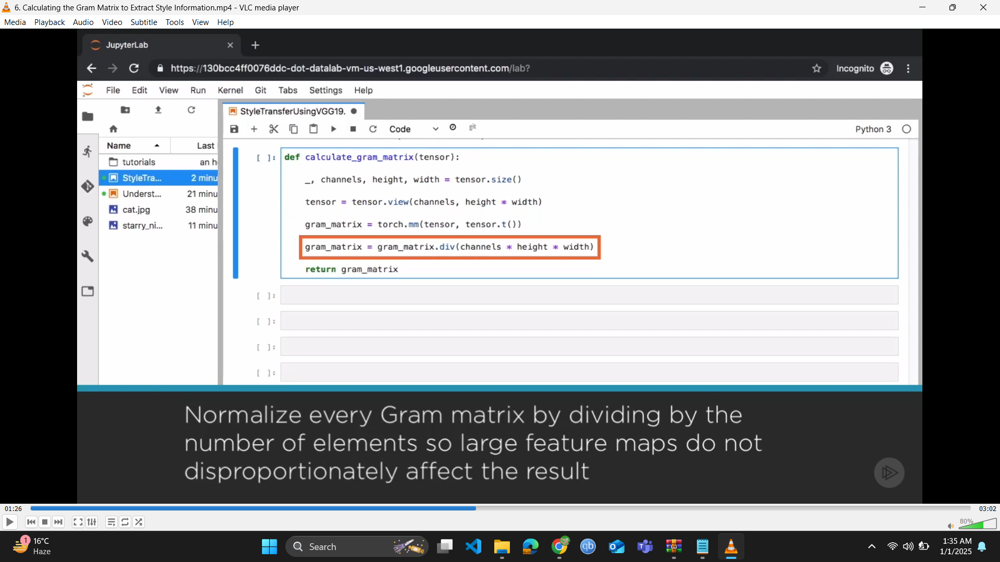

00:01:35.998 --> 00:01:40.193
The initial feature maps in a convolutional neural network tend to be large,

00:01:40.194 --> 00:01:43.863
and the feature maps get smaller and smaller as the input

00:01:43.863 --> 00:01:46.823
passes through the layers of the CNN.

00:01:46.823 --> 00:01:50.192
Normalizing the Gram matrix in this manner is important so

00:01:50.192 --> 00:01:54.394
that the large feature maps of the earlier layers do not

00:01:54.394 --> 00:01:56.652
disproportionately affect the result.

00:01:56.652 --> 00:01:59.416
This Gram matrix is what we'll use to compute the style loss,

00:01:59.416 --> 00:02:04.392
and we don't want the larger feature maps to have a disproportionate impact.



In [ ]:
def calculate_gram_matrix(tensor):
    _, channels, height, width = tensor.size()

    tensor = tensor.view(channels, height * width)

    gram_matrix = torch.mm(tensor, tensor.t())

    gram_matrix = gram_matrix.div(channels * height * width)

    return gram_matrix

00:02:04.392 --> 00:02:05.990
I'm going to do some precomputation here.

00:02:05.991 --> 00:02:10.291
This will help us when we train the weights of our target image.

00:02:10.292 --> 00:02:14.755
I'm going to go ahead and precompute the Gram matrix representation of all of

00:02:14.755 --> 00:02:17.787
the feature maps and the layers in which we are interested.

00:02:17.788 --> 00:02:20.406
I'll do this, of course, for the style image alone.

00:02:20.406 --> 00:02:23.514
The Gram matrix is to get the style information.

00:02:23.514 --> 00:02:27.473
It doesn't make sense to apply it to the content image.

00:02:27.473 --> 00:02:32.173
I'll run a for loop through the keys of the style_img_features dictionary.

00:02:32.174 --> 00:02:34.634
This will give me all of the layers that we are interested in,

00:02:34.634 --> 00:02:36.385
and for each of these layers,

00:02:36.385 --> 00:02:42.448
I'll extract the feature maps and pass that in to calculate Gram matrix.

00:02:42.449 --> 00:02:45.791
The Gram matrix representation for all of the feature maps is now

00:02:45.791 --> 00:02:50.062
available in this style_features_gram_matrix dictionary.

00:02:50.062 --> 00:02:54.321
You can print out the Gram matrix to screen and see what it looks like.



00:02:54.321 --> 00:02:57.874
We have a Gram matrix representation for all of the feature maps

00:02:57.874 --> 00:03:03.868
for our layers of interest from the style image.


In [ ]:
style_features_gram_matrix = {layer: calculate_gram_matrix(style_img_features[layer]) for layer in style_img_features}

In [ ]:
style_features_gram_matrix

{'conv1_1': tensor([[1.9222e-03, 1.5891e-03, 7.0480e-04,  ..., 2.3406e-03, 6.3957e-04,
          2.7048e-03],
         [1.5891e-03, 2.0978e-02, 2.5598e-04,  ..., 2.5365e-02, 3.0953e-03,
          1.1105e-02],
         [7.0480e-04, 2.5598e-04, 8.8238e-04,  ..., 2.2501e-05, 2.4211e-04,
          7.0670e-04],
         ...,
         [2.3406e-03, 2.5365e-02, 2.2501e-05,  ..., 1.6457e-01, 1.7922e-02,
          2.9846e-02],
         [6.3957e-04, 3.0953e-03, 2.4211e-04,  ..., 1.7922e-02, 6.6877e-03,
          2.9231e-03],
         [2.7048e-03, 1.1105e-02, 7.0670e-04,  ..., 2.9846e-02, 2.9231e-03,
          2.5564e-02]]),
 'conv2_1': tensor([[0.0282, 0.0034, 0.0157,  ..., 0.0227, 0.0012, 0.0060],
         [0.0034, 0.0282, 0.0085,  ..., 0.0563, 0.0037, 0.0043],
         [0.0157, 0.0085, 0.0465,  ..., 0.0437, 0.0017, 0.0074],
         ...,
         [0.0227, 0.0563, 0.0437,  ..., 0.3652, 0.0170, 0.0294],
         [0.0012, 0.0037, 0.0017,  ..., 0.0170, 0.0134, 0.0051],
         [0.0060, 0.0043, 0.0

00:00:01.042 --> 00:00:04.605
We'll extract style information from the feature map output of

00:00:04.605 --> 00:00:06.918
a number of different convolutional layers.

00:00:06.918 --> 00:00:10.365
The layers of the convolutional neural network in which we are

00:00:10.365 --> 00:00:14.069
interested for style information are all of these layers that you

00:00:14.069 --> 00:00:16.186
see within this weights dictionary.

00:00:16.187 --> 00:00:19.125
The weights dictionary here assigns the weights for the importance that we

00:00:19.125 --> 00:00:22.057
give to the style information from each of these layers.

00:00:22.057 --> 00:00:24.543
Earlier layers have higher weightage.

00:00:24.544 --> 00:00:29.670
Except for the convolutional layer 4_2, which we'll use for content information,

00:00:29.671 --> 00:00:34.335
we'll extract style information from the feature maps of all of these layers.


In [ ]:
weights = {'conv1_1': 1.0, 'conv2_1': 0.75, 'conv3_1': 0.35,
            'conv4_1': 0.25, 'conv5_1': 0.15}

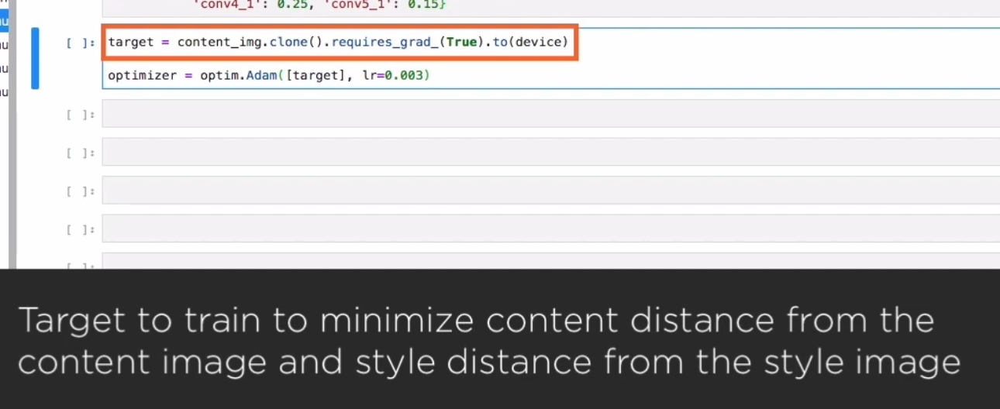


00:00:56.039 --> 00:00:59.033
Now this target image can be initialized with random dates.

00:00:59.033 --> 00:01:03.746
I've just choses to initialize it with the same content as the content image.

00:01:03.746 --> 00:01:07.157
Make sure requires_grad is True and copy the target image

00:01:07.157 --> 00:01:11.027
over to your GPU device for training.

00:01:11.027 --> 00:01:14.656
We'll use the Adam optimizer to train the weights of the target image.

00:01:14.657 --> 00:01:17.281
Observe that the input, or the learnable parameters,

00:01:17.281 --> 00:01:22.107
that we pass into Adam optimizer is this target tensor.


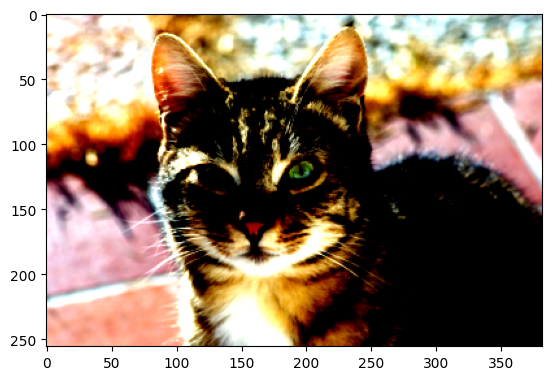

In [ ]:
target = content_img.clone().requires_grad_(True).to(device)

optimizer = optim.Adam([target], lr=0.003)

plt.figure()
plt.imshow(tensor_to_image(target))

00:01:29.110 --> 00:01:33.366
We are now finally ready to start the training process for style transfer,

00:01:33.367 --> 00:01:36.598
and we'll run training for about 2000 iterations.

00:01:36.599 --> 00:01:39.135
That's what this for loop sets up.

00:01:39.136 --> 00:01:40.274
As our very first step,

00:01:40.274 --> 00:01:44.960
we'll pass the target image through our VGG19 pretrained model.

00:01:44.961 --> 00:01:48.387
We'll do this by calling apply_model_and_extract_features,

00:01:48.387 --> 00:01:51.436
pass in the target image and the layers of the VGG model.

00:01:51.436 --> 00:01:55.057
This will return the target_features dictionary,

00:01:55.057 --> 00:01:58.695
which contains the feature map representations of our current target

00:01:58.695 --> 00:02:01.783
image for all of the layers that we are interested in.

00:02:01.783 --> 00:02:05.452
In order to minimize the content distance of the

00:02:05.452 --> 00:02:07.484
target image from the content image,

00:02:07.484 --> 00:02:11.686
we'll extract the content image from an early convolution block,

00:02:11.687 --> 00:02:14.017
the fourth block in this example.

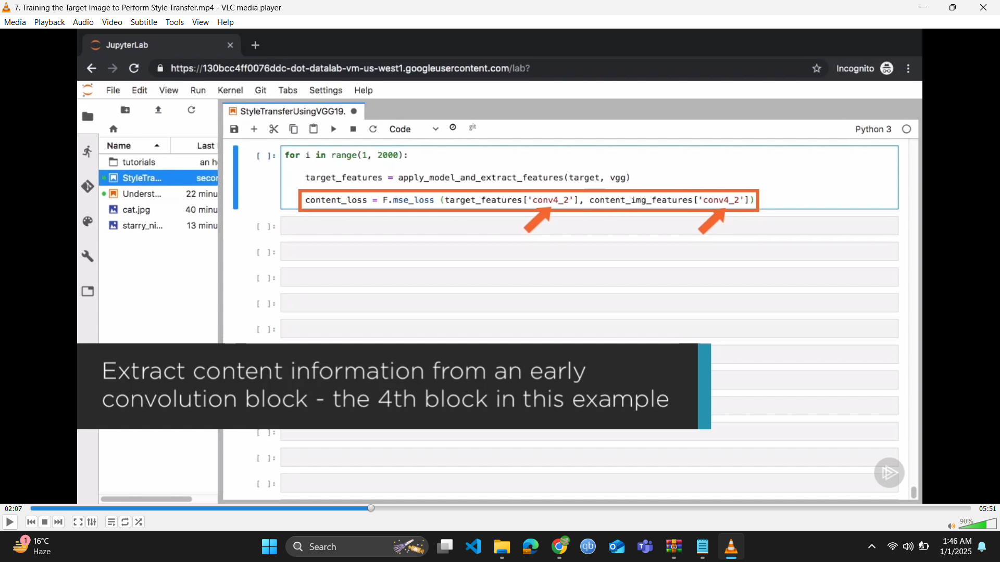

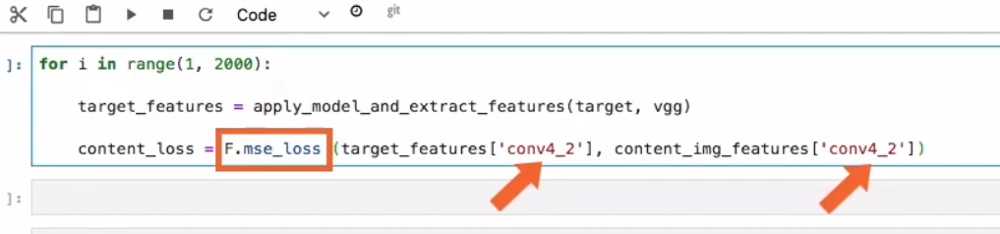

00:02:14.018 --> 00:02:17.770
We'll calculate the mean squared error loss between the feature map

00:02:17.770 --> 00:02:20.657
representation of this convolutional layer of the target image,

00:02:20.658 --> 00:02:22.393
as well as the content image.

00:02:22.394 --> 00:02:26.390
This will give us the content loss that we will minimize.

00:02:26.390 --> 00:02:30.984
Earlier convolutional layers contain more structure information.

00:02:30.984 --> 00:02:34.423
The mean squared error loss for content is only for the

00:02:34.423 --> 00:02:36.763
feature maps for this particular layer.



00:02:36.763 --> 00:02:39.846
We'll get style information from multiple layers,

00:02:39.846 --> 00:02:42.318
and we'll store the current style loss in the

00:02:42.318 --> 00:02:44.650
style_loss variable that I initialize to 0.

00:02:44.650 --> 00:02:49.548
The layers that we are interested in is present in the weights dictionary.

00:02:49.548 --> 00:02:52.816
These are the layers that we'll use to extract style information.

00:02:52.816 --> 00:02:55.557
Iterate over all of the layers in weights,

00:02:55.557 --> 00:03:00.283
and get the feature map results for that layer for our target

00:03:00.283 --> 00:03:03.046
image by indexing into target_features.

00:03:03.047 --> 00:03:06.385
The feature maps have already been generated when we pass the

00:03:06.385 --> 00:03:10.260
current target image through our VGG19 model.

00:03:10.260 --> 00:03:12.313
In order to get style information,

00:03:12.314 --> 00:03:17.569
we need to calculate the Gram matrix representation of our target features.

00:03:17.570 --> 00:03:21.172
Calculate this and store it in the result target_gram_matrix.

00:03:21.172 --> 00:03:27.697
We already have the style_gram_matrix for the same layer precalculated.

00:03:27.697 --> 00:03:30.482
We simply look up the Gram matrix representation of the style

00:03:30.482 --> 00:03:33.827
image for the same layer using our dictionary,

00:03:33.827 --> 00:03:36.011
style_features_gram_matrix.

00:03:36.011 --> 00:03:38.539
Now that we have the Gram matrix representation for the

00:03:38.539 --> 00:03:42.110
feature maps of the target image, as well as the style image,

00:03:42.110 --> 00:03:45.550
we are ready to calculate loss using the mse_loss function.

00:03:45.550 --> 00:03:50.797
This layer_loss is the loss for only this particular layer.

00:03:50.797 --> 00:03:52.853
Remember that I had said earlier that we'll extract

00:03:52.853 --> 00:03:55.543
style information from multiple layers.

00:03:55.543 --> 00:03:59.111
Multiply the layer_loss with the weight that we've assigned this layer.

00:03:59.111 --> 00:04:02.211
Remember, earlier layers have higher weights.

00:04:02.211 --> 00:04:07.078
Now the total style_loss is the sum total of all of the layer losses from

00:04:07.078 --> 00:04:10.328
the layers that we're using to extract style information,

00:04:10.328 --> 00:04:13.685
so add the current layer_loss to the style_loss.

00:04:13.686 --> 00:04:17.175
The scale of the style loss and the scale of the content loss is very,

00:04:17.175 --> 00:04:21.601
very different, which is why we multiply the style_loss by a large number.

00:04:21.601 --> 00:04:25.696
This is 10 to the power 6 so that the style losses and the content

00:04:25.696 --> 00:04:29.783
losses are more or less the same scale otherwise the impact of the

00:04:29.783 --> 00:04:33.686
style loss will be minimal and the style transfer will not occur in

00:04:33.686 --> 00:04:35.114
the way that you might expect.

00:04:35.114 --> 00:04:40.080
So the total_loss is the weighted sum of the style_loss and the content_loss.

00:04:40.081 --> 00:04:44.313
After every 50 iterations of training, I'm going to print out the Epoch,

00:04:44.314 --> 00:04:48.646
the Style Loss, and the Content Loss so that we can see how training progresses.

00:04:48.647 --> 00:04:52.943
All that's left to do now is to zero out the gradients of the optimizer,

00:04:52.944 --> 00:04:54.987
make a backward pass to calculate gradients,

00:04:54.987 --> 00:04:57.346
and call optimizer.step.

00:04:57.347 --> 00:05:01.258
Optimizer.step will update the weights of the target image,

00:05:01.258 --> 00:05:03.141
remember, not of the model.

00:05:03.141 --> 00:05:05.257
You're finally ready to run training.

00:05:05.257 --> 00:05:08.339
Hit Shift+Enter and start the training process.


In [ ]:
for i in range(1, 2000):

    target_features = apply_model_and_extract_features(target, vgg)

    content_loss = F.mse_loss(target_features['conv4_2'], content_img_features['conv4_2'])

    style_loss = 0

    for layer in weights:
        target_feature = target_features[layer]
        target_gram_matrix = calculate_gram_matrix(target_feature)
        style_gram_matrix = style_features_gram_matrix[layer]
        layer_loss = F.mse_loss(target_gram_matrix, style_gram_matrix)
        layer_loss *= weights[layer]

        _, channels, height, width = target_feature.shape
        style_loss += layer_loss

    total_loss = 1000000 * style_loss + content_loss

    if i % 50 == 0:
        print('Epoch {}: Style Loss: {:4f}, Content Loss: {:4f}'.format(i, style_loss, content_loss))

    # Backward pass
    optimizer.zero_grad()
    total_loss.backward()
    optimizer.step()

Epoch 50: Style Loss: 0.000318, Content Loss: 5.362263
Epoch 100: Style Loss: 0.000231, Content Loss: 5.949206
Epoch 150: Style Loss: 0.000195, Content Loss: 6.034871
Epoch 200: Style Loss: 0.000174, Content Loss: 6.012056
Epoch 250: Style Loss: 0.000158, Content Loss: 5.983163
Epoch 300: Style Loss: 0.000145, Content Loss: 5.942433
Epoch 350: Style Loss: 0.000134, Content Loss: 5.890031
Epoch 400: Style Loss: 0.000123, Content Loss: 5.840483
Epoch 450: Style Loss: 0.000113, Content Loss: 5.778970


In [ ]:
#  original img vs target img
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
ax1.imshow(tensor_to_image(content_img))
ax2.imshow(tensor_to_image(target))

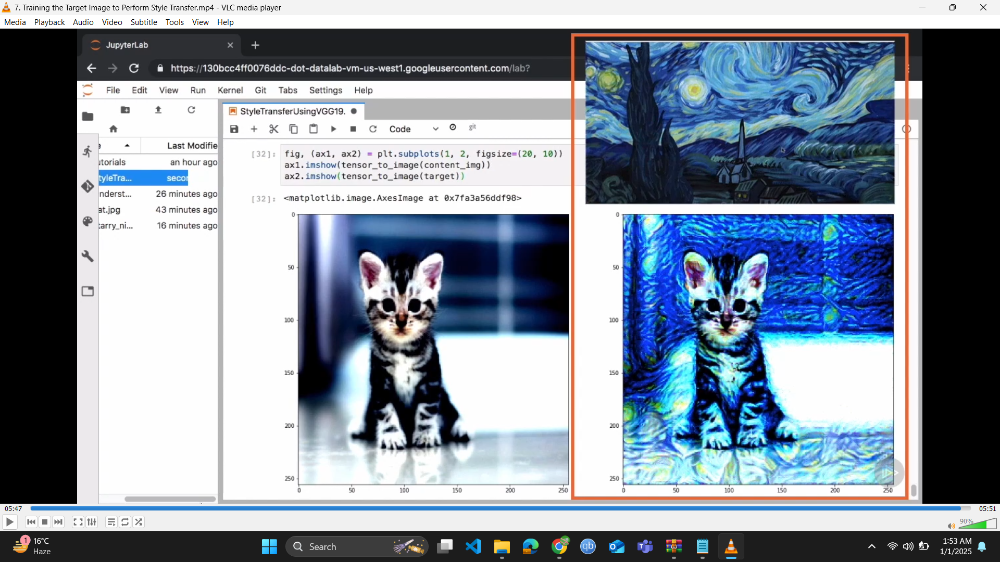

# ***alex net***

In [ ]:
import torch
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

import torch.optim as optim
from torchvision import models
from torchvision import transforms as tf
import torch.nn.functional as F

alexnet = models.alexnet(pretrained=True).features

for param in alexnet.parameters():
    param.requires_grad_(False)

In [ ]:
device = torch.device("cpu")

if torch.cuda.is_available():
    device = torch.device("cuda")

alexnet.to(device)

In [ ]:
mean = (0.485, 0.456, 0.406)
std = (0.229, 0.224, 0.225)

def transformation(img):
    tasks = tf.Compose([tf.Resize(256),
                        tf.ToTensor(),
                        tf.Normalize(mean, std)])
    img = tasks(img)
    img = img.unsqueeze(0)
    return img

In [ ]:
content_img = Image.open("cat.jpg").convert('RGB')
style_img = Image.open("starry night.jpg").convert('RGB')



In [ ]:
content_img.size

In [ ]:
content_img = transformation(content_img).to(device)
style_img = transformation(style_img).to(device)

In [ ]:
def tensor_to_image(tensor):
    image = tensor.clone().detach()
    image = image.cpu().numpy().squeeze()
    image = image.transpose(1, 2, 0)
    image *= np.array(std) + np.array(mean)
    image = image.clip(0, 1)
    return image

In [ ]:
img = tensor_to_image(style_img)
fig = plt.figure()
fig.suptitle('Style Image')
plt.imshow(img)

img = tensor_to_image(content_img)
fig = plt.figure()
fig.suptitle('Content Image')
plt.imshow(img)

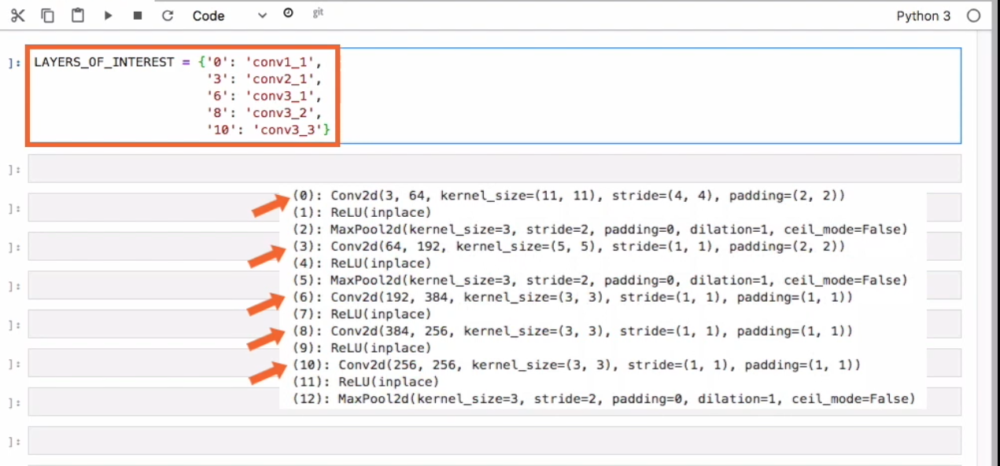

In [ ]:
LAYERS_OF_INTEREST = {'0': 'conv1_1',
                      '3': 'conv2_1',
                      '6': 'conv3_1',
                      '8': 'conv3_2',
                      '10': 'conv3_3'}

In [ ]:
def apply_model_and_extract_features(image, model):
    x = image
    features = {}

    for name, layer in model._modules.items():
        x = layer(x)

        if name in LAYERS_OF_INTEREST:
            features[LAYERS_OF_INTEREST[name]] = x

    return features

In [ ]:
content_img_features = apply_model_and_extract_features(content_img, alexnet)
style_img_features = apply_model_and_extract_features(style_img, alexnet)

In [ ]:
def calculate_gram_matrix(tensor):
    _, channels, height, width = tensor.size()

    tensor = tensor.view(channels, height * width)

    gram_matrix = torch.mm(tensor, tensor.t())

    gram_matrix = gram_matrix.div(channels * height * width)

    return gram_matrix

style_features_gram_matrix = {layer: calculate_gram_matrix(style_img_features[layer]) for layer in style_img_features}

In [ ]:
weights = {'conv1_1': 1.0, 'conv2_1': 0.8, 'conv3_1': 0.25}

target = content_img.clone().requires_grad_(True).to(device)

optimizer = optim.RMSprop([target], lr=0.003)

In [ ]:
for i in range(1, 2000):

    target_features = apply_model_and_extract_features(target, alexnet)

    content_loss = F.mse_loss(target_features['conv3_1'], content_img_features['conv3_1'])

    style_loss = 0

    for layer in weights:
        target_feature = target_features[layer]
        target_gram_matrix = calculate_gram_matrix(target_feature)
        style_gram_matrix = style_features_gram_matrix[layer]
        layer_loss = F.mse_loss(target_gram_matrix, style_gram_matrix)
        layer_loss *= weights[layer]

        _, channels, height, width = target_feature.shape
        style_loss += layer_loss

    total_loss = 1000000 * style_loss + content_loss

    if i % 50 == 0:
        print('Epoch {}: Style Loss: {:4f}, Content Loss: {:4f}'.format(i, style_loss, content_loss))

    optimizer.zero_grad()
    total_loss.backward()
    optimizer.step()

In [ ]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
ax1.imshow(tensor_to_image(content_img))
ax2.imshow(tensor_to_image(target))

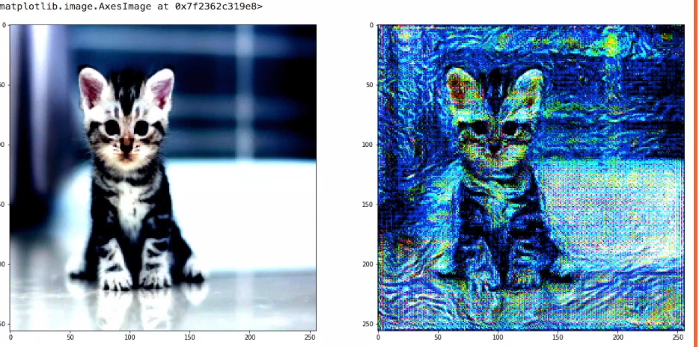

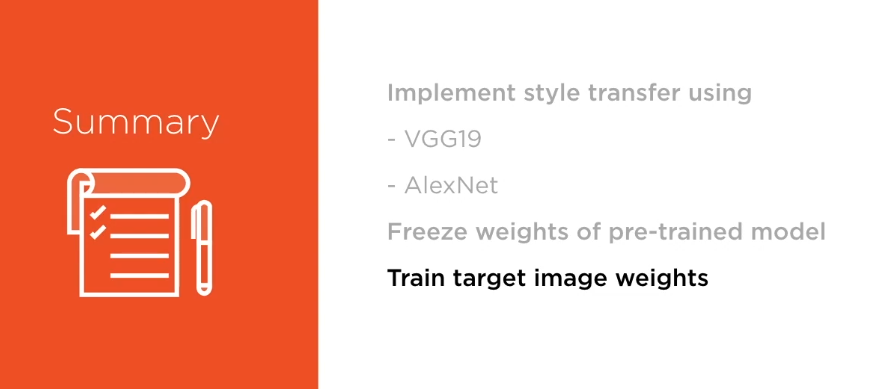